**Author:** Gavin DeBrun

In [36]:
import numpy as np
import matplotlib.pyplot as plt
from astropy import units as u
from astropy.coordinates import SkyCoord
from astroquery.mast import Tesscut
from glob import glob
import lightkurve as lk
from tess_stars2px import tess_stars2px_function_entry
import pandas as pd
from mpl_toolkits.axes_grid1 import make_axes_locatable
from IPython.display import HTML
from matplotlib import animation
import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 2**128

# Tabby's Star

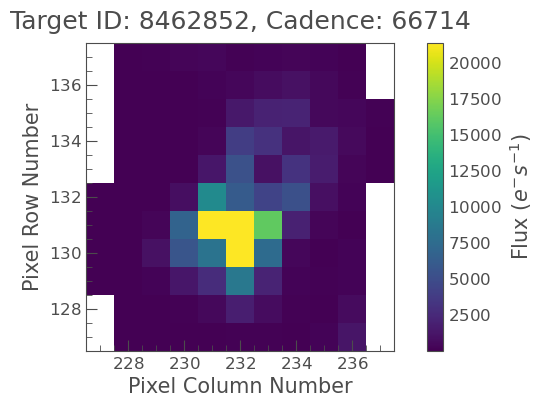

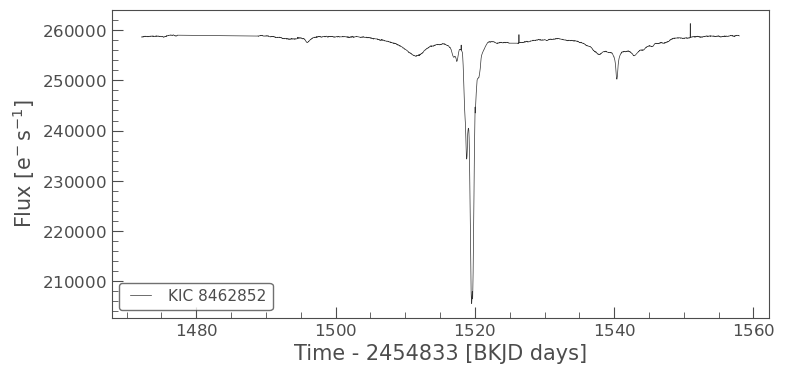

In [39]:
pixelfile = lk.search_targetpixelfile("KIC 8462852", quarter=16).download()
pixelfile.plot(frame=1)
lc = pixelfile.to_lightcurve(aperture_mask='all')
lc.plot()
plt.show()

# Epsilon Reticuli

The target I chose is Epsilon Reticuli A (HD 27442 A). It's a subgiant 60 ly from earth with a radius of $3.18R_{\odot}$, a mass of $1.5M_{\odot}$, a luminosity of $6.2L_{\odot}$, and an apparent magnitude of $4.44$. It's confirmed to have at least one gas giant exoplanet (HD 27442 b), discovered in 2000 through the radial velocity method. It has a mass of 1.56 Jupiters, with an orbital period of 428 days at a distance of 1.27 AU. Epsilon Reticuli A also has a companion white dwarf (HD 27442 B), with an orbital period of about 2,700 years at a distance of 240 AU, or 13 arcseconds. This white dwarf has a mass of $0.6M_{\odot}$, a radius of $0.0132R_{\odot}$, and an apparent magnitude of $12.5$.

I chose this target because I've performed the radial velocity analysis in another course, and I wanted to investigate its light curves to see if we could identify the exoplanet through the transit method. Further, TESS has observed Epsilon Reticuli 56,529 times between 2018 and 2023, providing a plethora of data. Given the orbital period of 428 days, there have been 4 orbits in this time. If the orbital plane is parallel with our line of sight, we might be able to detect the transit by observing decreases in flux.

#### Finding Epsilon Reticuli in the database

In [3]:
c = SkyCoord('04 16 28.933 -59 18 10.441', unit=(u.hourangle, u.deg)) 
ra, dec = c.ra.degree, c.dec.degree
outID, outEclipLong, outEclipLat, sectors, outCam, outCcd, outColPix, outRowPix, scinfo = tess_stars2px_function_entry(9999, ra, dec)
sectors = list(sectors)

#### Downloading Data

In [4]:
cutout_size = [51, 51]
force_download = False
RAstr, DECstr = str("{0:.6f}".format(ra)), str("{0:.6f}".format(dec))
coord_str = RAstr + '_' + DECstr
coords = SkyCoord(ra, dec, unit="deg")
fits_files = np.sort(glob('./*' + coord_str + '*.fits'))
bad_sectors = []

if fits_files.shape[0] != len(sectors) or force_download is True:
    
    for sector in sectors:

        skip = False

        for file in fits_files:

            file_sector = int(file[8:12])

            if sector == file_sector:

                skip = True

        if skip:

            continue

        print(f"Trying sector {sector}...")

        try:

            manifest = Tesscut.download_cutouts(coordinates=coords, size=cutout_size, sector=sector)

            print('\n')
            
        except Exception as e:

            bad_sectors.append(sector)
            print(e, "\n")
            continue
    
fits_files = np.sort(glob('./*' + coord_str + '*.fits'))

for bad_sector in bad_sectors:

    sectors.remove(bad_sector)

print(f"We have good data from sectors: {sectors}")

Trying sector 64...
400 Client Error: Bad Request for url: https://mast.stsci.edu/tesscut/api/v0.1/astrocut?ra=64.12055416666665&dec=-59.30290027777777&y=51&x=51&units=px&sector=64 

Trying sector 65...
400 Client Error: Bad Request for url: https://mast.stsci.edu/tesscut/api/v0.1/astrocut?ra=64.12055416666665&dec=-59.30290027777777&y=51&x=51&units=px&sector=65 

Trying sector 66...
400 Client Error: Bad Request for url: https://mast.stsci.edu/tesscut/api/v0.1/astrocut?ra=64.12055416666665&dec=-59.30290027777777&y=51&x=51&units=px&sector=66 

Trying sector 68...
400 Client Error: Bad Request for url: https://mast.stsci.edu/tesscut/api/v0.1/astrocut?ra=64.12055416666665&dec=-59.30290027777777&y=51&x=51&units=px&sector=68 

Trying sector 69...
400 Client Error: Bad Request for url: https://mast.stsci.edu/tesscut/api/v0.1/astrocut?ra=64.12055416666665&dec=-59.30290027777777&y=51&x=51&units=px&sector=69 

We have good data from sectors: [2, 3, 4, 5, 8, 12, 28, 29, 30, 31, 32, 35, 38, 39, 6

#### Reading in downloaded fits files

In [5]:
target_pixel_files = []
for i in range(len(fits_files)):

    try:
        
        target_pixel_files.append(lk.read(fits_files[i]))

    except Exception as e:

        print(e, "\n")
        continue


#### Animating all images

$\\$

**Note: I will also upload an HTML file to make this animation visible**

In [6]:
fig, ax = plt.subplots()
times = []
images = []
artists = []

i = 0
for tpf in target_pixel_files:

    curr_times = tpf.time.to_datetime()
    times.append(curr_times)
    fluxes = tpf.hdu[1].data['FLUX'][tpf.quality_mask]

    for j, flux in enumerate(fluxes):

        if i % 100 == 0:
            
            img = ax.imshow(flux, norm = 'log', vmin = 10, vmax = np.max(flux))
            text = ax.annotate(f"{curr_times[j]}", (0,50))
            plt.close()
            images.append(img)
            artists.append([img, text])

        i += 1
    
times = np.concatenate(times).ravel()
print(f"Dates range from {times[0]} to {times[-1]} with {len(times)} observations")
assert np.array_equal(np.sort(times), times) # times are alredy sorted, so we can just stack the images to generate an animation

ax_divider = make_axes_locatable(ax)
cax = ax_divider.append_axes('right', size = '7%', pad='2%', label = 'flux')
cb = fig.colorbar(img, cax=cax)
cb.set_label(r"Flux $(e^{-}s^{-1})$", rotation = 270, labelpad=20, size=12)
ax.set_title("Flux of Epsilon Reticuli A for all Sectors")
ax.set_ylabel("Pixel Row Number")
ax.set_xlabel("Pixel Column Number")
ani = animation.ArtistAnimation(fig, artists, interval=25, blit=True)

HTML(ani.to_jshtml())

Dates range from 2018-08-23 15:16:30.515862 to 2023-04-06 09:30:08.184360 with 56529 observations


#### Setting up our aperture masks for each sector

The CCD is oversaturated and we have electron overflow, so I've adjusted the target aperture to capture the overflow, hence the odd shape. Further, there are a lot of objects nearby, so I've added 3 small background aperture masks so that we have a good measurement of background flux. 

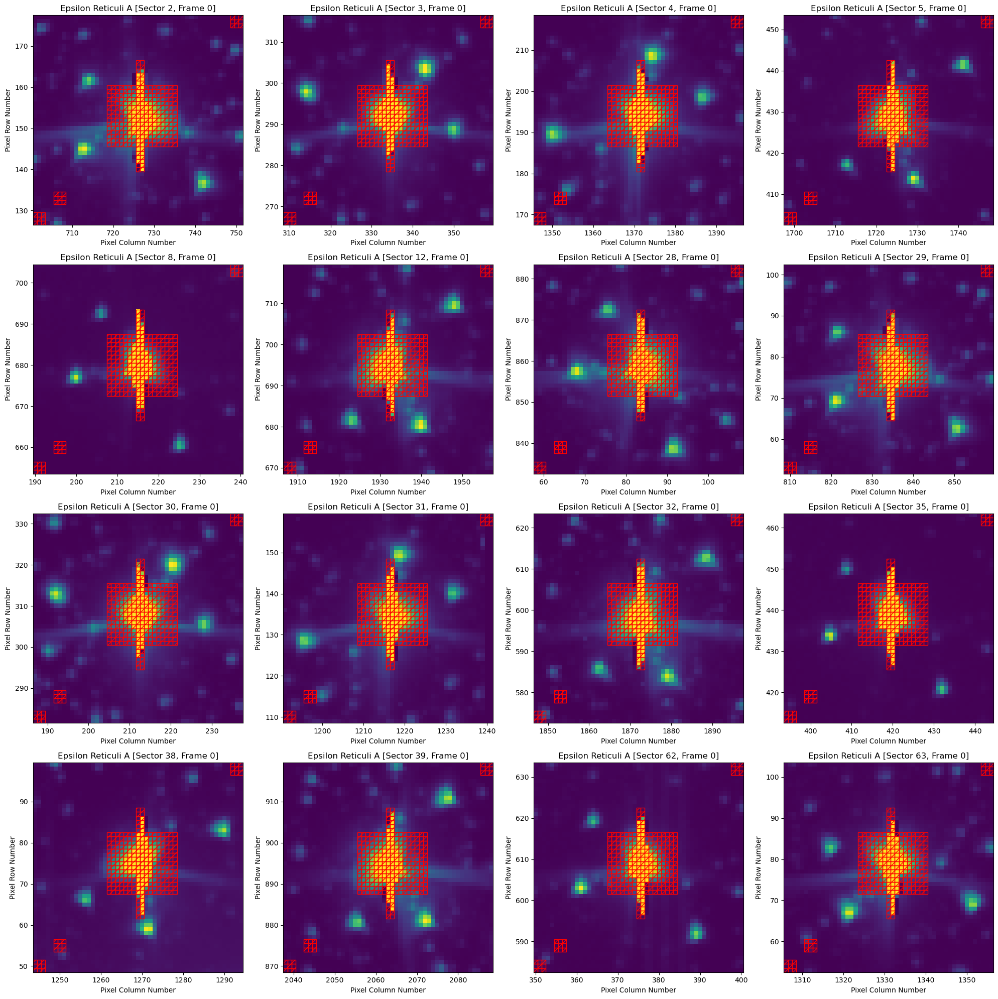

In [7]:
n_files = len(target_pixel_files)
fig, axes = plt.subplots(nrows = 4, ncols = 4, figsize = (20, 20))
targ_lcs = []
background_lcs = []

idx = 0
for row in axes:

    for ax in row:

        tpf = target_pixel_files[idx]
        
        targ_aper = np.full(tpf.flux[0].shape, False)
        targ_aper[19:34, 18:35] = True
        targ_aper[13:40, 25:27] = True
        background_aper = np.full(tpf.flux[0].shape, False)
        background_aper[5:8,5:8] = True
        background_aper[0:3,0:3] = True
        background_aper[-3:,-3:] = True

        N_targ_pix, N_background_pix = targ_aper.sum(), background_aper.sum()
        
        lc_bkg = tpf.to_lightcurve(aperture_mask=background_aper) / N_background_pix
        lc_targ = tpf.to_lightcurve(aperture_mask=targ_aper) - lc_bkg.flux * N_targ_pix

        background_lcs.append(lc_bkg)
        targ_lcs.append(lc_targ.normalize())

        img = tpf.plot(frame=0, ax = ax, show_colorbar=False, aperture_mask = targ_aper+background_aper, scale = 'log')
        ax.set_title(f"Epsilon Reticuli A [Sector {tpf.sector}, Frame 0]")
    
        idx += 1
        
fig.tight_layout()
plt.show()

The apertures look good, so now we can extract the lightcurves.

#### Plotting lightcurves for each sector

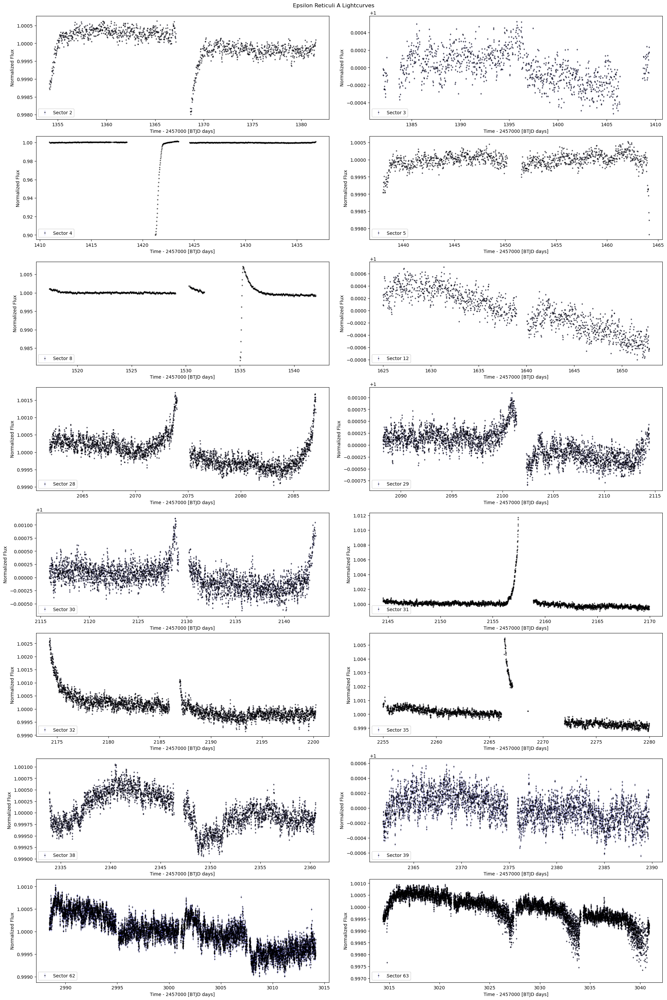

In [8]:
fig, axes = plt.subplots(nrows = 8, ncols = 2, figsize = (20,30), constrained_layout=True)

i = 0
for row in axes:

    for ax in row:

        targ_lcs[i].errorbar(ax=ax, color='b', alpha=0.5,marker='o',mfc='black',mec='black',ms=2, label = f'Sector {sectors[i]}')
        i += 1
        ax.legend(loc='lower left')
        
fig.suptitle("Epsilon Reticuli A Lightcurves")
plt.show()

The most glaring anomalies we see in the lightcurves are in sector 4 and 8, in which we see a sudden approximate 10% and 3% drop in flux respectively. This is followed by a return to the previous baseline. Could these be exoplanet transits? To be sure, let's look at what the background flux is doing during these periods.

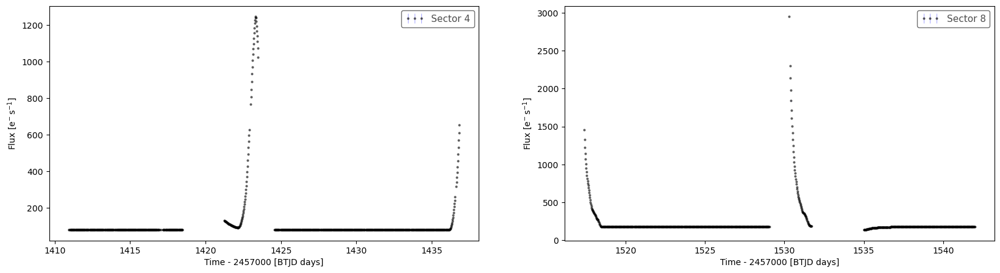

In [9]:
fig, axes = plt.subplots(nrows = 1, ncols = 2, figsize = (20, 5))
background_lcs[2].errorbar(ax = axes[0], color='b', alpha=0.5,marker='o',mfc='black', mec='black',ms=2, label = 'Sector 4')
background_lcs[4].errorbar(ax = axes[1], color='b', alpha=0.5,marker='o',mfc='black', mec='black',ms=2, label = 'Sector 8')
plt.show()

We see an order of magnitude increase in the background flux recoreed in sectors 4 and 8, followed by a return to normal. To visualize this further, we can plot the pixel data from before and during these increases.

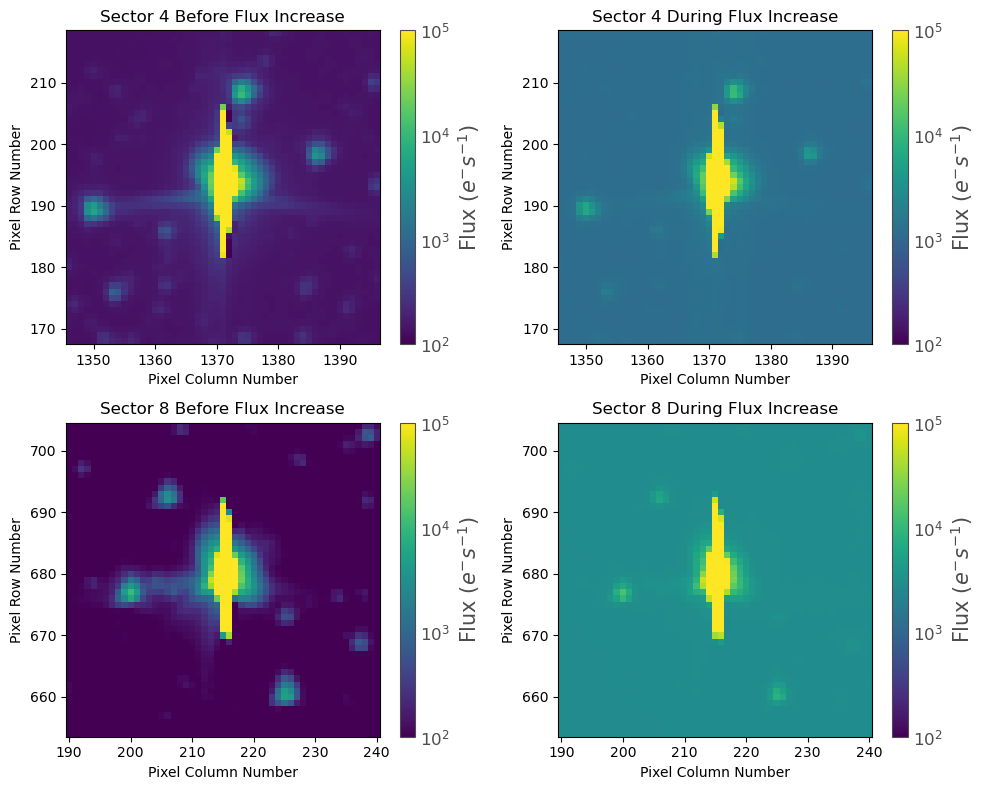

In [33]:
fig, axes = plt.subplots(nrows = 2, ncols = 2, figsize = (10, 8))

target_pixel_files[2].plot(frame = 400, ax = axes[0][0], scale = 'log', vmin = 100, vmax = 1e5)
axes[0][0].set_title("Sector 4 Before Flux Increase")

target_pixel_files[2].plot(frame = 436, ax = axes[0][1], scale = 'log', vmin = 100, vmax = 1e5)
axes[0][1].set_title("Sector 4 During Flux Increase")

target_pixel_files[4].plot(frame = 400, ax = axes[1][0], scale = 'log', vmin = 100, vmax = 1e5)
axes[1][0].set_title("Sector 8 Before Flux Increase")

target_pixel_files[4].plot(frame = 556, ax = axes[1][1], scale = 'log', vmin = 100, vmax = 1e5)
axes[1][1].set_title("Sector 8 During Flux Increase")

fig.tight_layout()
plt.show()

Now we can confirm that the sharp decrease in the target flux is due to this order of magnitude increase in background flux, as we subtract out the background from the target. I hypothesize that this is a sensor issue. 

Other than these observations, there is not much that we can conclusively determine about Epsilon Reticuli A's light curves. We do see some oscillations, but they seem to be irregular. We can determine, however, that this a noisy environment. There are multiple objects nearby that prevent us from expanding the aperature to the size that we need to capture all the flux from the target. Observation with a higher resolution sensor may help detect exoplanet transits.